In [46]:
import Pkg
Pkg.add("DelimitedFiles")
Pkg.add("StatsBase")

    Updating registry at `~/.julia/registries/General.toml`


   Resolving package versions...


  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


   Resolving package versions...


  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


In [94]:
numNeighbors = 15
numPoints = 20640
#numPoints = 4000

#numClusters = 10 # we figure out what this value is based of the first gap in eigenvalues

20640

In [95]:
using DelimitedFiles
filepath = "./housing.csv"
data = readdlm(filepath, ',')

# 1000 data points, 199 dimensions of features


20641×10 Matrix{Any}:
     "longitude"    "latitude"    "housing_median_age"  …  "ocean_proximity"
 -122.23          37.88         41.0                       "NEAR BAY"
 -122.22          37.86         21.0                       "NEAR BAY"
 -122.24          37.85         52.0                       "NEAR BAY"
 -122.25          37.85         52.0                       "NEAR BAY"
 -122.25          37.85         52.0                    …  "NEAR BAY"
 -122.25          37.85         52.0                       "NEAR BAY"
 -122.25          37.84         52.0                       "NEAR BAY"
 -122.25          37.84         52.0                       "NEAR BAY"
 -122.26          37.84         42.0                       "NEAR BAY"
    ⋮                                                   ⋱  
 -121.4           39.33         15.0                       "INLAND"
 -121.45          39.26         15.0                       "INLAND"
 -121.53          39.19         27.0                       "INLAND"
 -121.5

In [96]:
#data_num = Float64.(data[2:numPoints+1,1:9]) # removed the tile rows and columns, turn into float
data_num = data[2:20641,1:8]

#data_num = shuffle(data[2:20641,1:8]) # shuffles order of data
data_num = Float64.(data_num[1:numPoints, :])


# helpful slicing guide: https://web.eecs.umich.edu/~fessler/course/551/julia/tutor/04-slice.html

20640×8 Matrix{Float64}:
 -122.23  37.88  41.0   880.0   129.0   322.0   126.0  8.3252
 -122.22  37.86  21.0  7099.0  1106.0  2401.0  1138.0  8.3014
 -122.24  37.85  52.0  1467.0   190.0   496.0   177.0  7.2574
 -122.25  37.85  52.0  1274.0   235.0   558.0   219.0  5.6431
 -122.25  37.85  52.0  1627.0   280.0   565.0   259.0  3.8462
 -122.25  37.85  52.0   919.0   213.0   413.0   193.0  4.0368
 -122.25  37.84  52.0  2535.0   489.0  1094.0   514.0  3.6591
 -122.25  37.84  52.0  3104.0   687.0  1157.0   647.0  3.12
 -122.26  37.84  42.0  2555.0   665.0  1206.0   595.0  2.0804
 -122.25  37.84  52.0  3549.0   707.0  1551.0   714.0  3.6912
    ⋮                                     ⋮            
 -121.4   39.33  15.0  2655.0   493.0  1200.0   432.0  3.5179
 -121.45  39.26  15.0  2319.0   416.0  1047.0   385.0  3.125
 -121.53  39.19  27.0  2080.0   412.0  1082.0   382.0  2.5495
 -121.56  39.27  28.0  2332.0   395.0  1041.0   344.0  3.7125
 -121.09  39.48  25.0  1665.0   374.0   845.0   330.0 

In [97]:
#data_num = typeof(data[292,5])
#data_num = Float64.(data[2:291,1:9])

In [98]:
#data_num = Float64.(data[2:3,2:4]) # removed the tile rows and columns

In [99]:
using StatsBase
using Random
#https://juliastats.org/StatsBase.jl/stable/transformations/#Unit-range-normalization-1

#applied normalization
X = standardize(ZScoreTransform, data_num, dims=2) #standardizing accross the columns, so dims=2
#UnitRangeTransform, ZScoreTransform

#same as above
# dt = fit(ZScoreTransform, data_num; dims=2, center=true, scale=true)
# StatsBase.transform(dt, data_num)

X = transpose(X) # rows are dimensions, columns are datapoints
X = X[:, shuffle(1:numPoints)]
#X = X[:, 1:999]

8×20640 Matrix{Float64}:
 -0.822366  -0.723124  -0.858429    …  -0.804464  -0.935012   -0.747388
 -0.720586  -0.579268  -0.534657       -0.639978  -0.597018   -0.608216
 -0.734676  -0.581305  -0.534764       -0.665311  -0.611691   -0.602859
  2.02896    2.27376    1.75952         1.97721    1.7622      2.18734
  0.133857  -0.135319  -0.607058       -0.111051  -0.0951702  -0.13752
  0.755376   0.48133    1.36615     …   1.05207    1.33844     0.692593
  0.100656  -0.130604   0.00956958     -0.134746  -0.187933   -0.149405
 -0.74122   -0.60547   -0.600327       -0.673733  -0.673811   -0.634548

In [101]:
using DataFrames
using NearestNeighbors
kdtree = KDTree(X)


KDTree{StaticArraysCore.SVector{8, Float64}, Euclidean, Float64}
  Number of points: 20640
  Dimensions: 8
  Metric: Euclidean(0.0)
  Reordered: true

In [102]:
idx, dists = knn(kdtree, X, numNeighbors + 1, true)

([[1, 6536, 7896, 1443, 12960, 12766, 11723, 1522, 20465, 4318, 20147, 133, 5098, 8212, 6400, 4384], [2, 13971, 8819, 13366, 17228, 10198, 14934, 8192, 12639, 396, 8316, 272, 7897, 4127, 20320, 318], [3, 7293, 8782, 6761, 4130, 18108, 2738, 15825, 11786, 852, 2147, 7928, 13909, 829, 2190, 5298], [4, 13633, 13349, 204, 2915, 17247, 20454, 13145, 6565, 19090, 13801, 9147, 20200, 1179, 12139, 14693], [5, 18534, 13539, 7895, 16439, 6403, 12932, 16723, 10793, 7987, 10108, 19084, 11910, 14185, 18471, 10826], [6, 20358, 1152, 17910, 15145, 10705, 17504, 2512, 12972, 1668, 16709, 11692, 14046, 13372, 813, 3052], [7, 9435, 20070, 12966, 1079, 19972, 7393, 9249, 20504, 15801, 15745, 14281, 5055, 8802, 8214, 14722], [8, 3185, 9017, 3000, 14607, 585, 6863, 7898, 6436, 17090, 15724, 1384, 13590, 13595, 17275, 11068], [9, 6627, 1950, 784, 18654, 1389, 5065, 6030, 6802, 17135, 7725, 16230, 7969, 13918, 8241, 15306], [10, 13645, 3571, 10214, 17992, 13980, 7547, 14525, 2277, 15477, 8559, 14069, 15958, 

In [103]:
idx

20640-element Vector{Vector{Int64}}:
 [1, 6536, 7896, 1443, 12960, 12766, 11723, 1522, 20465, 4318, 20147, 133, 5098, 8212, 6400, 4384]
 [2, 13971, 8819, 13366, 17228, 10198, 14934, 8192, 12639, 396, 8316, 272, 7897, 4127, 20320, 318]
 [3, 7293, 8782, 6761, 4130, 18108, 2738, 15825, 11786, 852, 2147, 7928, 13909, 829, 2190, 5298]
 [4, 13633, 13349, 204, 2915, 17247, 20454, 13145, 6565, 19090, 13801, 9147, 20200, 1179, 12139, 14693]
 [5, 18534, 13539, 7895, 16439, 6403, 12932, 16723, 10793, 7987, 10108, 19084, 11910, 14185, 18471, 10826]
 [6, 20358, 1152, 17910, 15145, 10705, 17504, 2512, 12972, 1668, 16709, 11692, 14046, 13372, 813, 3052]
 [7, 9435, 20070, 12966, 1079, 19972, 7393, 9249, 20504, 15801, 15745, 14281, 5055, 8802, 8214, 14722]
 [8, 3185, 9017, 3000, 14607, 585, 6863, 7898, 6436, 17090, 15724, 1384, 13590, 13595, 17275, 11068]
 [9, 6627, 1950, 784, 18654, 1389, 5065, 6030, 6802, 17135, 7725, 16230, 7969, 13918, 8241, 15306]
 [10, 13645, 3571, 10214, 17992, 13980, 7547, 1452

In [104]:
#turns vector within vector into matrix
idxMatrix = mapreduce(permutedims, vcat, idx)

20640×16 Matrix{Int64}:
     1   6536   7896   1443  12960  …    133   5098   8212   6400   4384
     2  13971   8819  13366  17228       272   7897   4127  20320    318
     3   7293   8782   6761   4130      7928  13909    829   2190   5298
     4  13633  13349    204   2915      9147  20200   1179  12139  14693
     5  18534  13539   7895  16439     19084  11910  14185  18471  10826
     6  20358   1152  17910  15145  …  11692  14046  13372    813   3052
     7   9435  20070  12966   1079     14281   5055   8802   8214  14722
     8   3185   9017   3000  14607      1384  13590  13595  17275  11068
     9   6627   1950    784  18654     16230   7969  13918   8241  15306
    10  13645   3571  10214  17992     14069  15958  12119   9248  19098
     ⋮                              ⋱                                  ⋮
 20632  18673   2310  19317   8550     10470  18872  17478   8877    494
 20633   1424  19407  20392   1450      5367  16503   8582   4484  13414
 20634  12380  12146   8631

In [105]:
# adjancency list (list of indexes for k nearest neighbors at each index): 
neighbors = idxMatrix[:,2:numNeighbors + 1]


20640×15 Matrix{Int64}:
  6536   7896   1443  12960  12766  …    133   5098   8212   6400   4384
 13971   8819  13366  17228  10198       272   7897   4127  20320    318
  7293   8782   6761   4130  18108      7928  13909    829   2190   5298
 13633  13349    204   2915  17247      9147  20200   1179  12139  14693
 18534  13539   7895  16439   6403     19084  11910  14185  18471  10826
 20358   1152  17910  15145  10705  …  11692  14046  13372    813   3052
  9435  20070  12966   1079  19972     14281   5055   8802   8214  14722
  3185   9017   3000  14607    585      1384  13590  13595  17275  11068
  6627   1950    784  18654   1389     16230   7969  13918   8241  15306
 13645   3571  10214  17992  13980     14069  15958  12119   9248  19098
     ⋮                              ⋱      ⋮                       
 18673   2310  19317   8550   8751     10470  18872  17478   8877    494
  1424  19407  20392   1450  14389      5367  16503   8582   4484  13414
 12380  12146   8631  15237   30

In [106]:
adj = zeros(numPoints, numPoints)

20640×20640 Matrix{Float64}:
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 ⋮                        ⋮              ⋱            ⋮                   
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.

In [107]:
#create adjancency matrix
for i in 1:numPoints 
    for j in 1:numNeighbors
      adj[i, neighbors[i, j]] = 1
      adj[neighbors[i, j], i] = 1
    end
  end

In [108]:
adj

20640×20640 Matrix{Float64}:
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 ⋮                        ⋮              ⋱            ⋮                   
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.

In [109]:
degree = zeros(numPoints, numPoints)  

20640×20640 Matrix{Float64}:
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 ⋮                        ⋮              ⋱            ⋮                   
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.

In [110]:
# create degree matrix
for i in 1:numPoints
    degree[i, i] = sum(adj[i,:])
  end

In [111]:
degree

20640×20640 Matrix{Float64}:
 19.0   0.0   0.0   0.0   0.0   0.0  …   0.0   0.0   0.0   0.0   0.0   0.0
  0.0  22.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0  25.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0  24.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0  16.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0  18.0  …   0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  ⋮                             ⋮    ⋱         ⋮                      
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0


In [112]:
# create laplacian matrix
laplacian = degree - adj

20640×20640 Matrix{Float64}:
 19.0   0.0   0.0   0.0   0.0   0.0  …   0.0   0.0   0.0   0.0   0.0   0.0
  0.0  22.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0  25.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0  24.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0  16.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0  18.0  …   0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  ⋮                             ⋮    ⋱         ⋮                      
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0
  0.0   0.0   0.0   0.0   0.0   0.0      0.0   0.0   0.0   0.0   0.0   0.0


In [113]:
# Compute eigenvalues and eigenvectors
using LinearAlgebra
eigenval, eigenvec = eigen(laplacian)

Eigen{Float64, Float64, Matrix{Float64}, Vector{Float64}}
values:
20640-element Vector{Float64}:
  5.28018628157376e-15
  0.02638751030400676
  0.06491399214693186
  0.10018843889196996
  0.11252900959613533
  0.1245543306141462
  0.16423383155378177
  0.19025499998449388
  0.2066258748034881
  0.2584991348362706
  ⋮
 32.95622125625615
 32.97840559373006
 33.042362719141956
 33.599706838489816
 33.77624645169386
 33.8049639225351
 34.6778615348786
 34.76359020630303
 35.51829865857527
vectors:
20640×20640 Matrix{Float64}:
 -0.00696058   0.00109855    0.00294659   …   1.30655e-12   1.70901e-9
 -0.00696058   0.0068039    -0.007391         3.94392e-17   8.07585e-17
 -0.00696058  -0.00856616   -0.0180636       -6.54358e-12   6.40648e-11
 -0.00696058   0.00593429   -0.00167592      -9.48878e-18  -2.77173e-14
 -0.00696058  -0.0166393    -0.0141847        1.74673e-13  -1.72218e-15
 -0.00696058  -0.000877796   0.00940625   …  -3.25981e-13  -2.78998e-6
 -0.00696058   0.00637967   -0.0103472    

In [114]:
# Optional, write values into CSV files
# writedlm("CAHousingDataEigenval.csv", eigenval)
# writedlm("CAHousingDataEigenvec.csv", eigenvec)

In [115]:
numClusters = 8

8

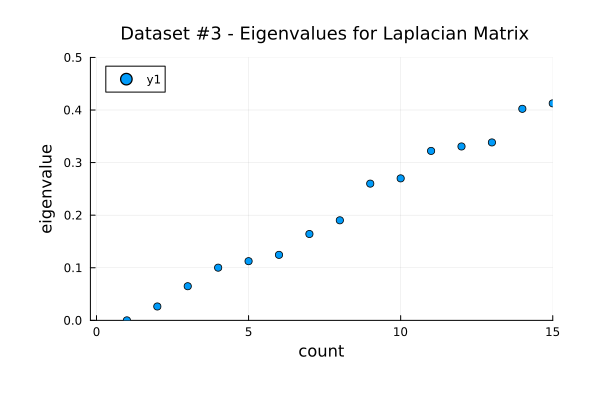

In [45]:
# Plot out eigenvalues to determine proper k to use for K means
using Plots.PlotMeasures

vals = data[1:15,:]
vals[9,:] = [0.26]
vals[10,:] = [0.27]
scatter(collect(1:15), vals, xlim=(-0.2, 15), ylim=(0,0.5), xlabel="count", ylabel="eigenvalue", title="\n Dataset #3 - Eigenvalues for Laplacian Matrix",titlefont=font(12), bottom_margin = 10mm, top_margin = 5mm, left_margin = 10mm, right_margin = 10mm)


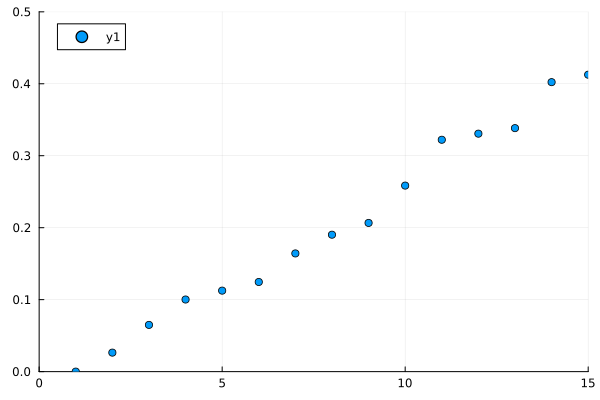

In [119]:
scatter(collect(1:999), eigenval, xlim=(0, 15), ylim=(0,0.5))

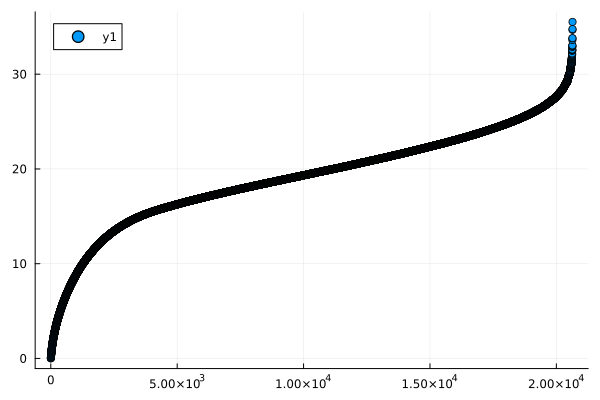

In [117]:
using Plots
scatter(collect(1:numPoints), eigenval)
# naturals vs eigenval

In [116]:
A = eigenvec[:,1:numClusters]
#A = eigenvec[:, 2:12]

20640×8 Matrix{Float64}:
 -0.00696058   0.00109855    0.00294659   …   0.00639045  -0.0121761
 -0.00696058   0.0068039    -0.007391        -0.00196822   0.00603888
 -0.00696058  -0.00856616   -0.0180636       -0.00212557  -0.000917204
 -0.00696058   0.00593429   -0.00167592      -0.0112455    0.00560004
 -0.00696058  -0.0166393    -0.0141847        0.0101248    0.00664611
 -0.00696058  -0.000877796   0.00940625   …   0.00670077   0.00448117
 -0.00696058   0.00637967   -0.0103472        0.0285595   -0.0030801
 -0.00696058  -0.00917178    0.00764023      -0.00706989   0.00107851
 -0.00696058   0.00476952    0.000491458     -0.00202662  -0.00688554
 -0.00696058  -0.0134881    -0.00105625      -0.0101242   -0.0114159
  ⋮                                       ⋱               
 -0.00696058   0.00623528   -0.00610102       0.00185511  -0.00182051
 -0.00696058   0.00698435   -0.01007          0.00227891   0.0123932
 -0.00696058  -0.0170608    -0.0157732        0.0132106    0.0103827
 -0.006960

In [27]:
using DelimitedFiles
filepath = "./CAHousingDataEigenval.csv"
data = readdlm(filepath, ',')



20640×1 Matrix{Float64}:
  5.28018628157376e-15
  0.02638751030400676
  0.06491399214693186
  0.10018843889196996
  0.11252900959613533
  0.1245543306141462
  0.16423383155378177
  0.19025499998449388
  0.2066258748034881
  0.2584991348362706
  ⋮
 32.95622125625615
 32.97840559373006
 33.042362719141956
 33.599706838489816
 33.77624645169386
 33.8049639225351
 34.6778615348786
 34.76359020630303
 35.51829865857527

KMeans

In [120]:
# Perform K-means clustering on rows of eigenvectors ordered based on samllest eigenvalue to largest eigenvalue
using RDatasets, Clustering
km = kmeans(transpose(A), numClusters)

KmeansResult{Matrix{Float64}, Float64, Int64}([-0.006960575579870182 -0.0069605755798695145 … -0.006960575579872262 -0.006960575579869567; -0.007174405928987448 -0.016140709119568577 … 0.003849394460012943 -0.011679709405273301; … ; -0.019186309489810247 0.009073668839776484 … -0.0013435768468165895 -0.006227921679550519; 0.0038191698146706637 0.006868189882763264 … -0.002226999915002914 -0.00563779700843472], [5, 3, 4, 3, 2, 6, 5, 8, 7, 8  …  7, 5, 3, 2, 8, 8, 5, 6, 8, 7], [8.384905399997045e-5, 1.4895459984646793e-5, 0.0001285914751307654, 0.00016496742452847349, 6.010053356585729e-6, 3.324395004423162e-5, 0.0008357870091577125, 0.00014748389820913317, 2.799678310459863e-5, 6.78126925032778e-5  …  3.544466427403344e-5, 7.984824599946248e-5, 0.0001517015998608838, 4.9524837669053055e-5, 5.255433157712872e-5, 5.4694962527854283e-5, 9.474551196807056e-5, 2.9798405069473015e-5, 3.7753012382598814e-5, 5.246174446439997e-5], [237, 1002, 3207, 202, 3760, 3824, 6037, 2371], [237, 1002, 3207,

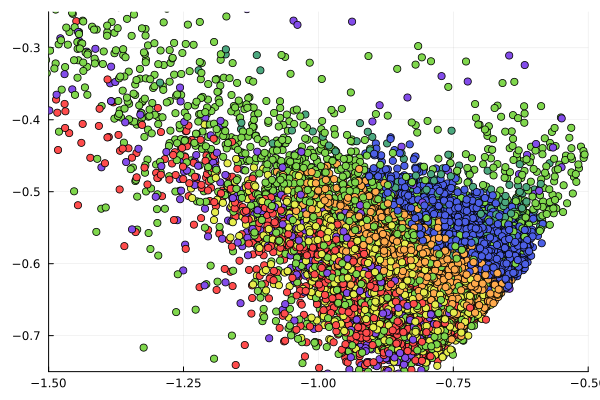

In [121]:
using Plots
s = 4
scatter(X[1,:], X[2, :], marker_z=km.assignments, color=:lightrainbow, legend=false, markersize=s, xlim=(-1.5,-0.5), ylim=(-0.75, -0.25))


In [122]:
X_orig = transpose(data_num)

8×20640 transpose(::Matrix{Float64}) with eltype Float64:
 -122.23    -122.22    -122.24    -122.25    …  -121.22  -121.32    -121.24
   37.88      37.86      37.85      37.85         39.43    39.43      39.37
   41.0       21.0       52.0       52.0          17.0     18.0       16.0
  880.0     7099.0     1467.0     1274.0        2254.0   1860.0     2785.0
  129.0     1106.0      190.0      235.0         485.0    409.0      616.0
  322.0     2401.0      496.0      558.0     …  1007.0    741.0     1387.0
  126.0     1138.0      177.0      219.0         433.0    349.0      530.0
    8.3252     8.3014     7.2574     5.6431        1.7      1.8672     2.3886

In [ ]:
using Plots
s = 4
scatter(X[1, :], X[2, :], marker_z=km.assignments, color=:lightrainbow, legend=true, markersize=s)


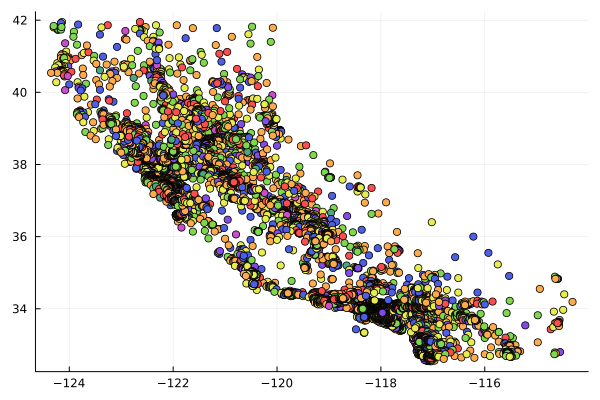

In [125]:

using Plots
s = 4
scatter(X_orig[1, :], X_orig[2, :], marker_z=km.assignments, color=:lightrainbow, legend=false, markersize=s)


In [126]:
# Access results

@assert nclusters(km) == numClusters # verify the number of clusters

a = assignments(km) # get the assignments of points to clusters
c = counts(km) # get the cluster sizes

#writedlm("cluster_sizes.txt", c)
# M = km.centers # get the cluster centers

8-element Vector{Int64}:
  237
 1002
 3207
  202
 3760
 3824
 6037
 2371